In [62]:
import pandas as pd
import sklearn
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.model_selection import train_test_split
import  seaborn as sns

In [63]:
df = pd.read_csv("Conversion Data Set.csv")

In [64]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   CustomerID           8000 non-null   int64  
 1   Age                  8000 non-null   int64  
 2   Gender               8000 non-null   object 
 3   Income               8000 non-null   int64  
 4   CampaignChannel      8000 non-null   object 
 5   CampaignType         8000 non-null   object 
 6   AdSpend              8000 non-null   float64
 7   ClickThroughRate     8000 non-null   float64
 8   ConversionRate       8000 non-null   float64
 9   WebsiteVisits        8000 non-null   int64  
 10  PagesPerVisit        8000 non-null   float64
 11  TimeOnSite           8000 non-null   float64
 12  SocialShares         8000 non-null   int64  
 13  EmailOpens           8000 non-null   int64  
 14  EmailClicks          8000 non-null   int64  
 15  PreviousPurchases    8000 non-null   i

In [65]:
import plotly.graph_objects as go
from plotly.subplots import make_subplots

In [67]:
df.drop(labels=["AdvertisingPlatform","AdvertisingTool"], axis = 1, inplace = True)

In [68]:
df["CampaignChannel"].unique()

array(['Social Media', 'Email', 'PPC', 'Referral', 'SEO'], dtype=object)

In [69]:
df["CampaignType"].unique()

array(['Awareness', 'Retention', 'Conversion', 'Consideration'],
      dtype=object)

In [70]:
df['SocialMedia'] = np.where(df["CampaignChannel"] == "Social Media",1,0)


In [71]:
df.head()

,CustomerID,Age,Gender,Income,CampaignChannel,CampaignType,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Lead,SocialMedia
0,8000,56,Female,136912,Social Media,Awareness,6497.870068,0.043919,0.088031,0,2.399017,7.396803,19,6,9,4,688,1,1
1,8001,69,Male,41760,Email,Retention,3898.668606,0.155725,0.182725,42,2.917138,5.352549,5,2,7,2,3459,1,0
2,8002,46,Female,88456,PPC,Awareness,1546.429596,0.277490,0.076423,2,8.223619,13.794901,0,11,2,8,2337,1,0
3,8003,32,Female,44085,PPC,Conversion,539.525936,0.137611,0.088004,47,4.540939,14.688363,89,2,2,0,2463,1,0
4,8004,60,Female,83964,PPC,Conversion,1678.043573,0.252851,0.109940,0,2.046847,13.993370,6,6,6,8,4345,1,0


In [72]:
df['PPC'] = np.where(df["CampaignChannel"] == "PPC",1,0)
df['Email'] = np.where(df["CampaignChannel"] == "Email",1,0)
df['Referral'] = np.where(df["CampaignChannel"] == "Referral",1,0)
df['SEO'] = np.where(df["CampaignChannel"] == "SEO",1,0)

In [73]:
df.head()

,CustomerID,Age,Gender,Income,CampaignChannel,CampaignType,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,...,EmailOpens,EmailClicks,PreviousPurchases,LoyaltyPoints,Lead,SocialMedia,PPC,Email,Referral,SEO
0,8000,56,Female,136912,Social Media,Awareness,6497.870068,0.043919,0.088031,0,...,6,9,4,688,1,1,0,0,0,0
1,8001,69,Male,41760,Email,Retention,3898.668606,0.155725,0.182725,42,...,2,7,2,3459,1,0,0,1,0,0
2,8002,46,Female,88456,PPC,Awareness,1546.429596,0.277490,0.076423,2,...,11,2,8,2337,1,0,1,0,0,0
3,8003,32,Female,44085,PPC,Conversion,539.525936,0.137611,0.088004,47,...,2,2,0,2463,1,0,1,0,0,0
4,8004,60,Female,83964,PPC,Conversion,1678.043573,0.252851,0.109940,0,...,6,6,8,4345,1,0,1,0,0,0


In [74]:
df['Awareness'] = np.where(df["CampaignType"] == "Awareness",1,0)
df['Retention'] = np.where(df["CampaignType"] == "Retention",1,0)
df['Consideration'] = np.where(df["CampaignType"] == "Consideration",1,0)
df['Conversion'] = np.where(df["CampaignType"] == "Conversion",1,0)

In [75]:
df.head()

,CustomerID,Age,Gender,Income,CampaignChannel,CampaignType,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,...,Lead,SocialMedia,PPC,Email,Referral,SEO,Awareness,Retention,Consideration,Conversion
0,8000,56,Female,136912,Social Media,Awareness,6497.870068,0.043919,0.088031,0,...,1,1,0,0,0,0,1,0,0,0
1,8001,69,Male,41760,Email,Retention,3898.668606,0.155725,0.182725,42,...,1,0,0,1,0,0,0,1,0,0
2,8002,46,Female,88456,PPC,Awareness,1546.429596,0.277490,0.076423,2,...,1,0,1,0,0,0,1,0,0,0
3,8003,32,Female,44085,PPC,Conversion,539.525936,0.137611,0.088004,47,...,1,0,1,0,0,0,0,0,0,1
4,8004,60,Female,83964,PPC,Conversion,1678.043573,0.252851,0.109940,0,...,1,0,1,0,0,0,0,0,0,1


In [76]:
df.describe()

,CustomerID,Age,Income,AdSpend,ClickThroughRate,ConversionRate,WebsiteVisits,PagesPerVisit,TimeOnSite,SocialShares,...,Lead,SocialMedia,PPC,Email,Referral,SEO,Awareness,Retention,Consideration,Conversion
count,8000.00000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,...,8000.000000,8000.000000,8000.000000,8000.000000,8000.000000,8000.00000,8000.00000,8000.000000,8000.00000,8000.000000
mean,11999.50000,43.625500,84664.196750,5000.944830,0.154829,0.104389,24.751625,5.549299,7.727718,49.799750,...,0.876500,0.189875,0.206875,0.194625,0.214875,0.19375,0.24850,0.243375,0.24850,0.259625
std,2309.54541,14.902785,37580.387945,2838.038153,0.084007,0.054878,14.312269,2.607358,4.228218,28.901165,...,0.329031,0.392227,0.405090,0.395936,0.410761,0.39526,0.43217,0.429146,0.43217,0.438456
min,8000.00000,18.000000,20014.000000,100.054813,0.010005,0.010018,0.000000,1.000428,0.501669,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.00000,0.000000
25%,9999.75000,31.000000,51744.500000,2523.221165,0.082635,0.056410,13.000000,3.302479,4.068340,25.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.00000,0.000000
50%,11999.50000,43.000000,84926.500000,5013.440044,0.154505,0.104046,25.000000,5.534257,7.682956,50.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.00000,0.000000
75%,13999.25000,56.000000,116815.750000,7407.989369,0.228207,0.152077,37.000000,7.835756,11.481468,75.000000,...,1.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.00000,0.000000,0.00000,1.000000
max,15999.00000,69.000000,149986.000000,9997.914781,0.299968,0.199995,49.000000,9.999055,14.995311,99.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.00000,1.00000,1.000000,1.00000,1.000000


In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8000 entries, 0 to 7999
Data columns (total 27 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   CustomerID         8000 non-null   int64  
 1   Age                8000 non-null   int64  
 2   Gender             8000 non-null   object 
 3   Income             8000 non-null   int64  
 4   CampaignChannel    8000 non-null   object 
 5   CampaignType       8000 non-null   object 
 6   AdSpend            8000 non-null   float64
 7   ClickThroughRate   8000 non-null   float64
 8   ConversionRate     8000 non-null   float64
 9   WebsiteVisits      8000 non-null   int64  
 10  PagesPerVisit      8000 non-null   float64
 11  TimeOnSite         8000 non-null   float64
 12  SocialShares       8000 non-null   int64  
 13  EmailOpens         8000 non-null   int64  
 14  EmailClicks        8000 non-null   int64  
 15  PreviousPurchases  8000 non-null   int64  
 16  LoyaltyPoints      8000 

In [112]:
import matplotlib.cm as cm

In [134]:
fig, axes = plt.subplots(4, 3, figsize=(35,35), dpi = 400)
fig.suptitle("Distribution of Different Features", fontsize = 20, fontweight = "bold")
#Age
sns.histplot(data = df, ax = axes[0,0], x = df["Age"].values)
axes[0,0].set_title("Age Distribution")
#social media wrt age
sns.histplot(data = df, ax = axes[0,1], x = "CampaignChannel", y = "Age", cmap = 'RdYlGn_r')
axes[0,1].set_title("Campaign Channel Age Distribution")
#Age Distribution Based On Campaign Type
sns.histplot(data = df, ax = axes[0,2], x = "CampaignType", y = "Age", cmap = 'RdYlGn_r')
axes[0,2].set_title("Campaign Type Age Distribution")
#Ad Spend and Channel Distribution
sns.histplot(data = df, ax = axes[1,0], x = "CampaignChannel", y = "AdSpend", cmap = 'RdYlGn_r')
axes[1,0].set_title("Ads Spend Distribution Based on Channel")
#Ad Spend distribution based Campaign Type
sns.histplot(data = df, ax = axes[1,1], x = "CampaignType", y = "AdSpend", cmap = 'RdYlGn_r')
axes[1,1].set_title("Ads Spend Distribution Based on Campaign Type")
#CTR Distribution
sns.histplot(data = df, ax = axes[1,2], x = "CampaignType", y = "ClickThroughRate", cmap = 'RdYlGn_r')
axes[1,2].set_title("CTR Distribution Based on Campaign Type")
#Conversion Rate Distribution
sns.histplot(data = df, ax = axes[2,0], x = "CampaignType", y = "ConversionRate", cmap = 'RdYlGn_r')
axes[2,0].set_title("Conv. Rate Distribution Based on Camaign Type")
#CTR vs Conversion Rate
sns.scatterplot(data = df, ax = axes[2,1], x = "ConversionRate", y = "ClickThroughRate", hue = 'Lead')
axes[2,1].set_title("CTR vs Conversion Rate Based on Campaign Type")
#PagesPerVisit vs Conversion Rate
sns.scatterplot(data = df, ax = axes[2,2], x = "PagesPerVisit", y = "ConversionRate", hue = 'Lead')
axes[2,2].set_title("Pages Per Visit vs Conversion Rate")
#Previous Purchases vs Conversion Rate
sns.scatterplot(data = df, ax = axes[3,0], x = "PreviousPurchases", y = "ConversionRate", hue = 'Lead')
axes[3,0].set_title("Previous Purchasers vs Conversion Rate")
#Time on Site vs Conversion Rate
sns.scatterplot(data = df, ax = axes[3,1], x = "TimeOnSite", y = "ConversionRate", hue = 'Lead')
axes[3,1].set_title("Time on Site vs Conversion Rate")
#Website Visitsvs Conversion Rate
sns.scatterplot(data = df, ax = axes[3,2], x = "WebsiteVisits", y = "ConversionRate", hue = 'Lead')
axes[3,2].set_title("Website Visits vs Conversion Rate")

Text(0.5, 1.0, 'Website Visits vs Conversion Rate')

Text(0.5, 1.0, 'Website Visits vs Conversion Rate')

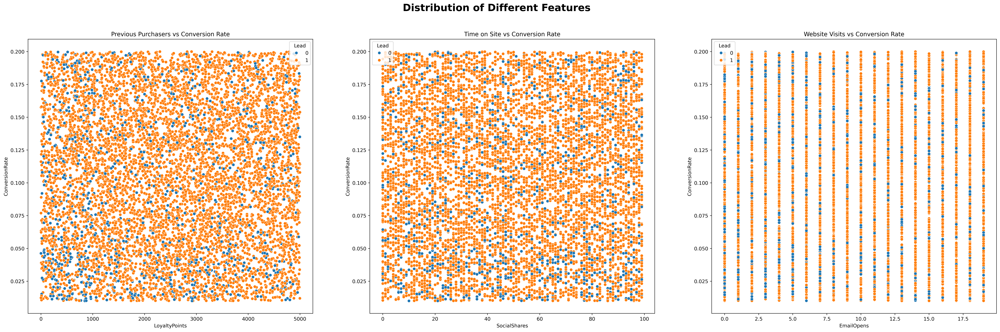

In [136]:
fig, axes = plt.subplots(1, 3, figsize=(35,10), dpi = 400)
fig.suptitle("Distribution of Different Features", fontsize = 20, fontweight = "bold")
#Loyalty Points 
sns.scatterplot(data = df, ax = axes[0], x = "LoyaltyPoints", y = "ConversionRate", hue = 'Lead')
axes[0].set_title("Loyalty Points vs Conversion Rate")
#Time on Site vs Conversion Rate
sns.scatterplot(data = df, ax = axes[1], x = "SocialShares", y = "ConversionRate", hue = 'Lead')
axes[1].set_title("Social Shares vs Conversion Rate")
#Website Visitsvs Conversion Rate
sns.scatterplot(data = df, ax = axes[2], x = "EmailOpens", y = "ConversionRate", hue = 'Lead')
axes[2].set_title("Email Opens vs Conversion Rate")


We will now look into correlation between metrics we have discussed above and conversions.
We will calculate Cramers V to understand the correlation between different features and lead column

In [154]:

import scipy.stats as ss
confusion_matrix = pd.crosstab(df['SocialMedia'], 
df['Lead'], margins=True, margins_name="subtotal")

print(confusion_matrix)

Lead           0     1  subtotal
SocialMedia                     
0            788  5693      6481
1            200  1319      1519
subtotal     988  7012      8000


In [155]:
chi, p, dof, expected = ss.chi2_contingency(confusion_matrix)

In [161]:
p

np.float64(0.8854600900096363)

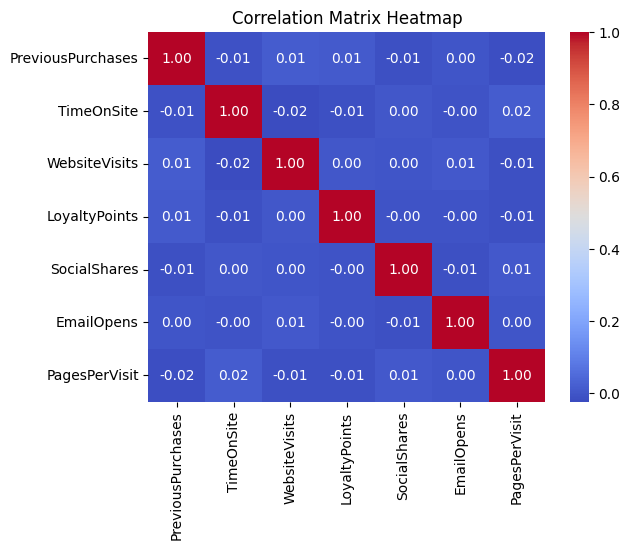

In [160]:
#plotting the correlation matrix
correlation_matrix = df[ ['PreviousPurchases', 'TimeOnSite', 'WebsiteVisits', 'LoyaltyPoints', 'SocialShares', 'EmailOpens','PagesPerVisit']].corr()

sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")

plt.title('Correlation Matrix Heatmap')

plt.show()

There's no correlation between above mentioned metrics.

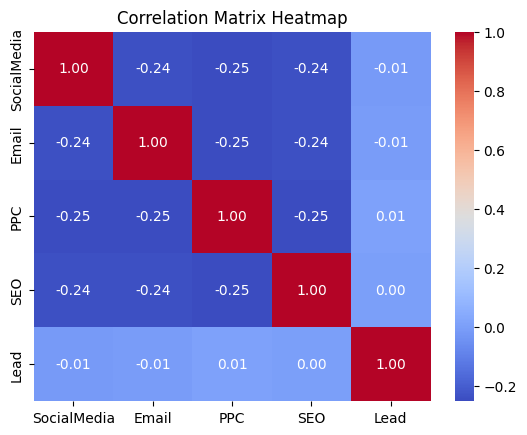

In [162]:

correlation_matrix_2 = df[ ['SocialMedia', 'Email', 'PPC', 'SEO','Lead']].corr()

sns.heatmap(correlation_matrix_2, annot=True, cmap='coolwarm', fmt=".2f")

plt.title('Correlation Matrix Heatmap')

plt.show()